In [1]:
import os, random
from unicodedata import name
import pandas as pd
import numpy as np
import scipy.stats as stats
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from model_1 import apaDNNModel, apaDataset
import pickle
# from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from utils import *
import seqlogo
import logomaker

/home/aiden/anaconda3/envs/for_DL/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [9]:
def plot_filter_logos(filters):
        outname = "filter_" + str(filter) + ".png"
        for i in range(len(filters)):
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            cpm = seqlogo.CompletePM(filters[i], alphabet_type='RNA')
            outname = "logs/" + cpm.consensus + "{}_.png".format(i)
            # seqlogo.seqlogo the filter for each ax[i]
            seqlogo.seqlogo(cpm, ax=ax[i], ic_scale=False, format='png', size='medium')
            # save the figure
            plt.savefig(outname)
    
def test_performance(model, test_data_loader, device):
    target_list, pred_list = [], []
    valid_loss, valid_R = 0.0, 0.0
    cells_res = {}
    model.eval()
    # make a empty torch tensor to save the filters of the first conv layer
    filters = []
    with torch.no_grad():
        for batch_idx, batch in enumerate(test_data_loader):
            seq_X, celltype, celltype_name, Y = batch
            out = model(seq_X, celltype)
            # filters:
            # get the filters of the first conv layer
            filters.append(model.conv_block_1.op[0].weight.data)
        stacked_activations = torch.stack(filters, dim=0).to(device)
        print("stacked_activations shape: ", stacked_activations.shape)
        mean_activations = torch.mean(stacked_activations, dim=0).to(device)
        print("mean_activations shape: ", mean_activations.shape)
        #
        ## lets turn the activatoions into RNA pwms
        ppms = F.softmax(mean_activations, dim=1)
        # loop over the filters and save in a list:
        filter_lst = []
        for filter in range(ppms.shape[0]):
            filter_lst.append(ppms[filter,:,:].cpu().numpy())
        # plot the filters:
        plot_filter_logos(filter_lst)
    

data_root = "data/"
test_data = np.load(data_root + "sALS_test_labels.npy", allow_pickle=True)
test_seq = np.load(data_root + "sALS_test_seqs.npy", allow_pickle=True)

profiles = pd.read_csv(data_root + "celltype_profiles.tsv", index_col=0, sep="\t")
test_data_loader = DataLoader(
apaDataset(test_seq, test_data, profiles, device='cuda'),
batch_size=1024,
drop_last=False,
)

model = apaDNNModel(
    opt="Adam",
    loss="mse",
    lambda1=50,
    device='cuda',
    # Conv block 1 hparamaters
    conv1kc=128,
    conv1ks=12,
    conv1st=1,
    pool1ks=25,
    pool1st=25,
    cnvpdrop1=0.2,
    # multihead attention block
    Matt_heads=8,
    Matt_drop = 0.2,
    # FC block 1 (Matt output flattened)
    fc1_L1=0,  # 8192
    fc1_L2=8192,
    fc1_L3=4048,
    fc1_L4=1024,
    fc1_L5=512,
    fc1_L6=256,
    fc1_dp1=0.3,
    fc1_dp2=0.25,
    fc1_dp3=0.25,
    fc1_dp4=0.2,
    fc1_dp5=0.1,
    # FC block 2 (celltype profile + overall representation)
    fc2_L1=0,
    fc2_L2=128,
    fc2_L3=32,
    fc2_L4=16,
    fc2_L5=1,
    fc2_dp1=0.2,
    fc2_dp2=0.2,
    fc2_dp3=0,
    fc2_dp4=0,
    lr=2.5e-05,
    adam_weight_decay=0.06,
)
model.compile()
model.load_state_dict(
    torch.load(
        "data/all_cells_CNN_Matt_V2_4_L2_sALS_resNET.pt"
    ,map_location=torch.device('cuda'))
)
model.to("cuda")

apaDNNModel(
  (conv_block_1): ConvBlock(
    (op): Sequential(
      (0): Conv1d(4, 128, kernel_size=(12,), stride=(1,), padding=(6,))
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ELU(alpha=1.0)
      (3): MaxPool1d(kernel_size=25, stride=25, padding=0, dilation=1, ceil_mode=False)
      (4): Dropout(p=0.2, inplace=False)
    )
  )
  (Matt_1): MultiheadAttention(
    (out_proj): _LinearWithBias(in_features=128, out_features=128, bias=True)
  )
  (fc1): FC_block(
    (op): Sequential(
      (0): Linear(in_features=20480, out_features=8192, bias=True)
      (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): Dropout(p=0.3, inplace=False)
      (4): Linear(in_features=8192, out_features=4048, bias=True)
      (5): BatchNorm1d(4048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (6): ReLU()
      (7): Dropout(p=0.25, inplace=False)
      (8): Lin

In [10]:
# 1- get_filter_activations for all the filters for all the sequences in test data set
# 2- loop over the test_data_loader and get the feature maps for each sequence
# 3- loop over the feature maps and get the filter activations for each filter
# 4- loop over the filter activations and get the subsequence for each filter activation
# 5- loop over the subsequences and get the motif for each subsequence

window=12
window_left = int(window/2)
window_right = window - window_left
Threshold=0.7
filter_pwms = {'filter_{}'.format(i):[] for i in range(128)}
count_matrix = {'filter_{}'.format(i):[] for i in range(128)}
with torch.no_grad():
    for filter_index in range(128):
        filter_name = 'filter_{}'.format(filter_index)
        print("processing filter number : ", filter_index + 1)
        for batch_idx, batch in enumerate(test_data_loader):
            seq_X, celltype, celltype_name, Y = batch
            feature_map = model.conv_block_1.op[0](seq_X.to('cuda'))
            fmap = feature_map.cpu().detach().numpy()
            seq_X = seq_X.cpu().detach().numpy()
            dat_idx, position_idx = np.where(fmap[:,filter_index,:] > np.max(fmap[:,filter_index,:])*0.7)
            for i in range(len(dat_idx)):
                # handle boundary conditions at start
                start_window = position_idx[i] - window_left
                if start_window < 0:
                    start_buffer = np.zeros((4,-start_window))
                    start = 0
                else:
                    start = start_window
                # handle boundary conditions at end
                end_window = position_idx[i] + window_right
                if end_window > seq_X.shape[2]:
                    end_buffer = np.zeros((4,end_window - seq_X.shape[2]))
                    end = seq_X.shape[2]
                else:
                    end = end_window
                sub_seq = seq_X[dat_idx[i],:,start:end]
                
                
                if start_window < 0:
                    sub_seq = np.hstack([start_buffer, sub_seq])
                if end_window - seq_X.shape[2] > 0:
                    sub_seq = np.hstack([sub_seq, end_buffer])
                weight = fmap[dat_idx[i],filter_index,start:end]
                weight = weight[np.newaxis,:] # add the channel dimensions
                # pad the weight to length of 12 if it is less than 12 with zeros
                if weight.shape[1] < 12:
                    weight = np.hstack([weight, np.zeros((1,12-weight.shape[1]))])
                    
                sub_seq = sub_seq*weight
                filter_pwms[filter_name].append(sub_seq)
                count_matrix[filter_name].append(np.sum(sub_seq, axis=1, keepdims=True)*weight)
        filter_pwms[filter_name] = np.array(filter_pwms[filter_name])
        count_matrix[filter_name] = np.array(count_matrix[filter_name])
        # normalize the weighted subsequence
        filter_pwms[filter_name] = np.sum(filter_pwms[filter_name], axis=0)/np.sum(count_matrix[filter_name], axis=0)*np.ones((4,window))
        filter_pwms[filter_name][np.isnan(filter_pwms[filter_name])] = 0
    
# save the filter_pwms dictionary into a pickle file
with open('data/filter_pwms_sALS_CNN_Matt_V2_4_L2_resNet.pkl', 'wb') as handle:
    pickle.dump(filter_pwms, handle, protocol=pickle.HIGHEST_PROTOCOL)

processing filter number :  1
processing filter number :  2
processing filter number :  3
processing filter number :  4
processing filter number :  5
processing filter number :  6
processing filter number :  7
processing filter number :  8
processing filter number :  9
processing filter number :  10
processing filter number :  11
processing filter number :  12
processing filter number :  13
processing filter number :  14
processing filter number :  15
processing filter number :  16
processing filter number :  17
processing filter number :  18
processing filter number :  19
processing filter number :  20
processing filter number :  21
processing filter number :  22
processing filter number :  23
processing filter number :  24
processing filter number :  25
processing filter number :  26
processing filter number :  27
processing filter number :  28
processing filter number :  29
processing filter number :  30
processing filter number :  31
processing filter number :  32
processing filter

In [11]:
# a function to make MEME file for  filters
def make_meme_file(filter_pwms, name):
    """Takes in a dictionary of filter pwms and writes a meme file"""

    with open('Meme_files/{}_filter_pwms.meme'.format(name), 'w') as f:
        f.write('MEME version 4\n\n')
        f.write('ALPHABET= ACGU\n\n')
        f.write('strands: + -\n\n')
        f.write('Background letter frequencies (from uniform background):\n')
        f.write('A 0.25000 C 0.25000 G 0.25000 U 0.25000\n\n')
        for i in range(len(filter_pwms)):
            # call your plotting function with the current dataframe and the subplot
            filter_name = 'filter_'+str(i)
            tst_filter = filter_pwms[filter_name]
            tst_filter[tst_filter < 0] = 0
            # Nan to zero
            tst_filter = pd.DataFrame(tst_filter.T, columns=['A','C','G','U'])
            tst_filter = tst_filter.apply(normalize_row_n, axis=1)
            tst_filter[np.isnan(tst_filter)] = 0.25
            f.write('MOTIF {}\n'.format(filter_name))
            f.write('letter-probability matrix: alength= 4 w= 8 nsites= 1 E= 0\n')
            for row in tst_filter.values:
                f.write(' '.join([str(x) for x in row])+'\n')
            f.write('\n')
    return

def normalize_row_n(row):
    max_val = row.max()
    other_vals = row[row != max_val]
    if other_vals.empty or all(other_vals >= 0.4 * max_val):
        return row / row.sum()
    else:
        # If there is a value less than 0.2 * max_val, modify the row
        # scale and then normalize the row
        small_vals = other_vals[other_vals < 0.2 * max_val]
        if not small_vals.empty:
            max_val += small_vals.sum()
            row[row.isin(small_vals)] = 0
            row[row == row.max()] = max_val
        return row / row.sum()

    
def plot_filter_processed_pwms(filter_pwms, name):
    """Takes in a dictionary of filter pwms and plots them in a 16x8 grid"""
    n_rows = 16
    n_cols = 8

    fig = plt.figure(figsize=(20, 20))

    for i in range(n_rows):
        for j in range(n_cols):
            # calculate the index of the current dataframe in the list
            df_index = i * n_cols + j
            
            if df_index >= 128:
                # if we have processed all the dataframes, break out of the loop
                break
            
            # create a subplot for the current index
            ax = fig.add_subplot(n_rows, n_cols, df_index + 1)
            
            # call your plotting function with the current dataframe and the subplot
            filter_name = 'filter_'+str(df_index)
            tst_filter = filter_pwms[filter_name]
            tst_filter[tst_filter < 0] = 0
            # Nan to zero
            tst_filter = pd.DataFrame(tst_filter.T, columns=['A','C','G','U'])
            tst_filter = tst_filter.apply(normalize_row_n, axis=1)
            tst_filter[np.isnan(tst_filter)] = 0.25
            logomaker.Logo(tst_filter,
                        shade_below=.5,
                        fade_below=.5,
                        font_name='Arial Rounded MT Bold',
                        ax=ax)
            ax.set_title(filter_name)

    plt.tight_layout()
    # plt.show()
    fig.savefig('filters_plots/{}_sALS_filter_logos_processed.png'.format(name), dpi=300)
    return plt

def plot_filter_raw_pwms(filter_pwms, name):
    """Takes in a dictionary of filter pwms and plots them in a 16x8 grid"""
    n_rows = 16
    n_cols = 8

    fig = plt.figure(figsize=(20, 20))

    for i in range(n_rows):
        for j in range(n_cols):
            # calculate the index of the current dataframe in the list
            df_index = i * n_cols + j
            
            if df_index >= 128:
                # if we have processed all the dataframes, break out of the loop
                break
            
            # create a subplot for the current index
            ax = fig.add_subplot(n_rows, n_cols, df_index + 1)
            
            # call your plotting function with the current dataframe and the subplot
            filter_name = 'filter_'+str(df_index)
            tst_filter = filter_pwms[filter_name]
            tst_filter[tst_filter < 0] = 0
            # Nan to zero
            tst_filter = pd.DataFrame(tst_filter.T, columns=['A','C','G','U'])
            logomaker.Logo(tst_filter,
                        shade_below=.5,
                        fade_below=.5,
                        font_name='Arial Rounded MT Bold',
                        ax=ax)
            ax.set_title(filter_name)

    plt.tight_layout()
    plt.show()
    fig.savefig('filters_plots/{}_sALS_filter_logos_raw.png'.format(name), dpi=300)
    return plt

findfont: Font family ['Arial Rounded MT Bold'] not found. Falling back to DejaVu Sans.


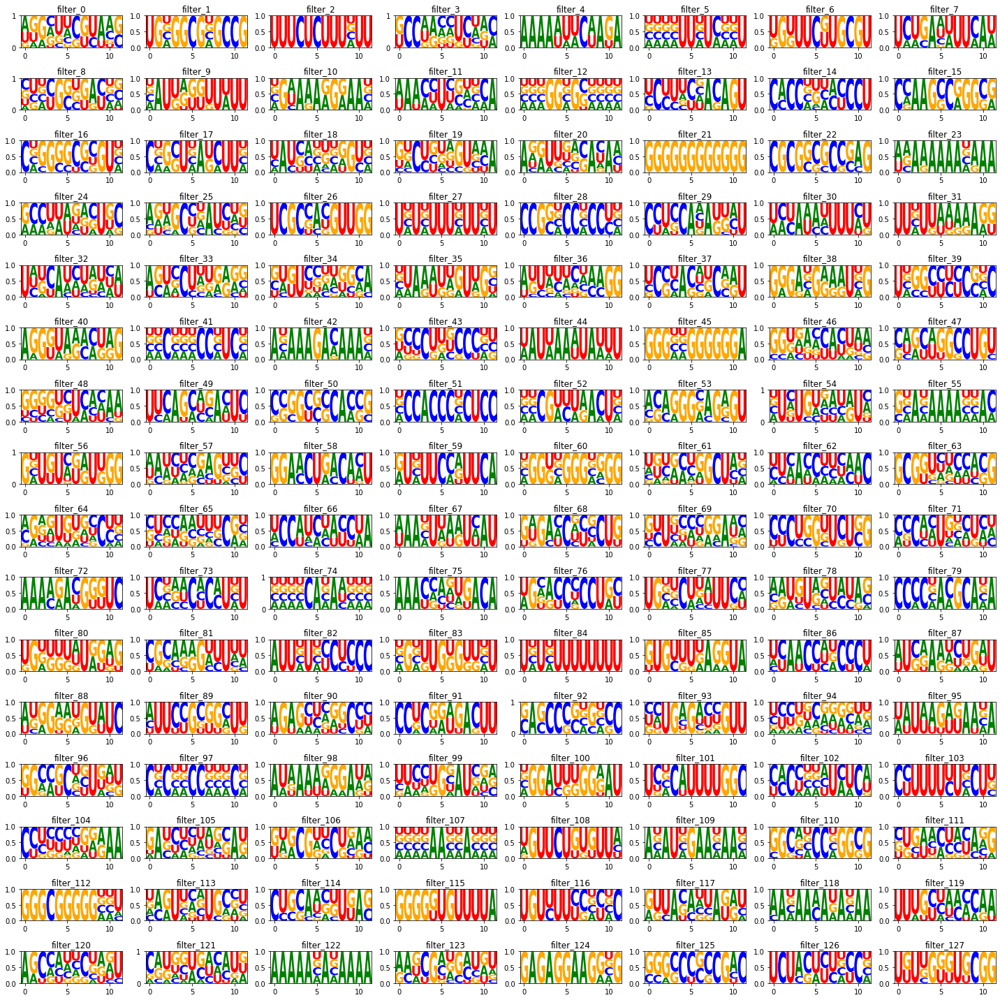

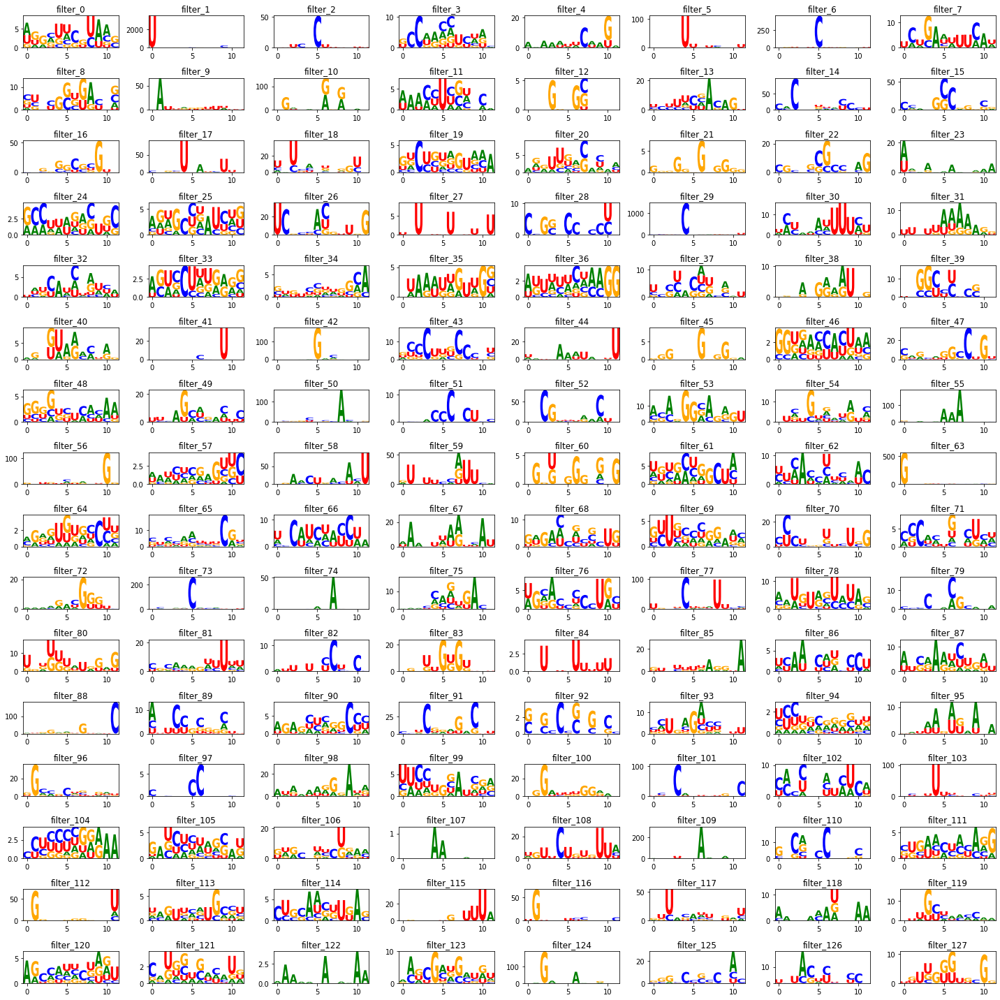

In [12]:
plot_filter_processed_pwms(filter_pwms, 'All_cts_processed')
plot_filter_raw_pwms(filter_pwms, 'All_cts_processed')
make_meme_file(filter_pwms, 'All_cts_sALS')

In [13]:
# make data loader for each cell type
device = 'cuda'
window=12
window_left = int(window/2)
window_right = window - window_left
Threshold=0.7
ct_filter_pwms = {}
filter_dict = {'filter_{}'.format(i):[] for i in range(128)}
for ct in profiles.columns:
    ct_filter_pwms[ct] = filter_dict.copy()
for ct in profiles.columns:
    celltype_name = ct.split(".")[0]
    print("processing celltype: {}".format(celltype_name))
    ct_df = profiles[[ct]]
    MINI_BATCH = 512
    # get the test_data for the celltype
    test_data_ct = test_data[test_data[:, 2] == celltype_name]
    SAMPLE_SIZE = test_data_ct.shape[0]

    df_data_loader = DataLoader(
    apaDataset(test_seq, test_data_ct, ct_df, device),
    batch_size=MINI_BATCH,
    shuffle=False,
    drop_last=False,
    )
    count_matrix = {'filter_{}'.format(i):[] for i in range(128)}
    with torch.no_grad():
        for filter_index in range(128):
            filter_name = 'filter_{}'.format(filter_index)
            # print("processing filter number : ", filter_index + 1)
            for batch_idx, batch in enumerate(df_data_loader):
                seq_X, celltype, celltype_name, Y = batch
                feature_map = model.conv_block_1.op[0](seq_X.to('cuda'))
                fmap = feature_map.cpu().detach().numpy()
                seq_X = seq_X.cpu().detach().numpy()
                dat_idx, position_idx = np.where(fmap[:,filter_index,:] > np.max(fmap[:,filter_index,:])*0.7)
                for i in range(len(dat_idx)):
                    # handle boundary conditions at start
                    start_window = position_idx[i] - window_left
                    if start_window < 0:
                        start_buffer = np.zeros((4,-start_window))
                        start = 0
                    else:
                        start = start_window
                    # handle boundary conditions at end
                    end_window = position_idx[i] + window_right
                    if end_window > seq_X.shape[2]:
                        end_buffer = np.zeros((4,end_window - seq_X.shape[2]))
                        end = seq_X.shape[2]
                    else:
                        end = end_window
                    sub_seq = seq_X[dat_idx[i],:,start:end]
                    
                    
                    if start_window < 0:
                        sub_seq = np.hstack([start_buffer, sub_seq])
                    if end_window - seq_X.shape[2] > 0:
                        sub_seq = np.hstack([sub_seq, end_buffer])
                    weight = fmap[dat_idx[i],filter_index,start:end]
                    weight = weight[np.newaxis,:] # add the channel dimensions
                    # pad the weight to length of 12 if it is less than 12 with zeros
                    if weight.shape[1] < 12:
                        weight = np.hstack([weight, np.zeros((1,12-weight.shape[1]))])
                        
                    sub_seq = sub_seq*weight
                    ct_filter_pwms[ct][filter_name].append(sub_seq)
                    count_matrix[filter_name].append(np.sum(sub_seq, axis=1, keepdims=True)*weight)
            ct_filter_pwms[ct][filter_name] = np.array(ct_filter_pwms[ct][filter_name])
            count_matrix[filter_name] = np.array(count_matrix[filter_name])
            # normalize the weighted subsequence
            ct_filter_pwms[ct][filter_name] = np.sum(ct_filter_pwms[ct][filter_name], axis=0)/np.sum(count_matrix[filter_name], axis=0)*np.ones((4,window))
            ct_filter_pwms[ct][filter_name][np.isnan(ct_filter_pwms[ct][filter_name])] = 0

processing celltype: Excitatory


processing celltype: Astrocytes
processing celltype: Inhibitory
processing celltype: Oligodendrocytes
processing celltype: Microglia
processing celltype: OPC
processing celltype: L5-6-CC
processing celltype: L2-3
processing celltype: AST-PP
processing celltype: IN-SST
processing celltype: IN-VIP
processing celltype: IN-PV
processing celltype: L4
processing celltype: AST-FB
processing celltype: IN-SV2C


/home/aiden/anaconda3/envs/for_DL/lib/python3.7/site-packages/ipykernel_launcher.py:71: RuntimeWarning: divide by zero encountered in true_divide
/home/aiden/anaconda3/envs/for_DL/lib/python3.7/site-packages/ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


processing celltype: L5-6


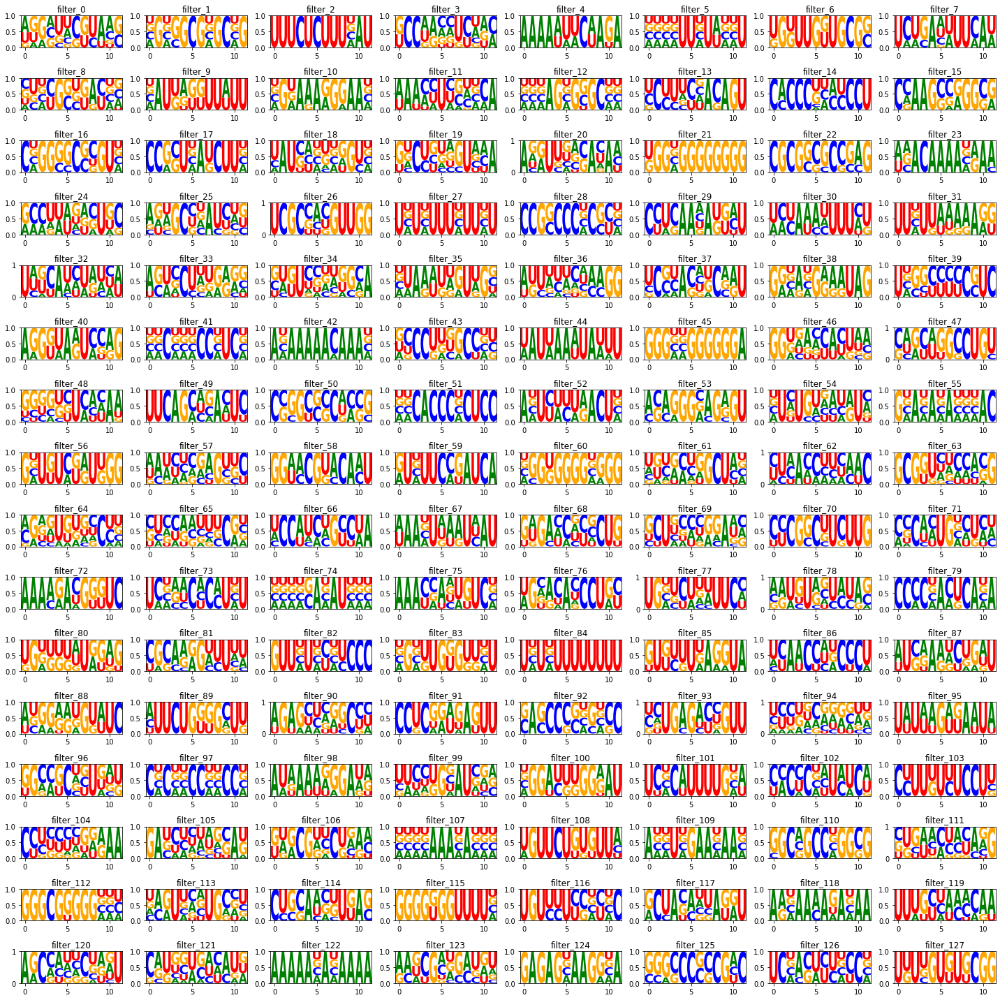

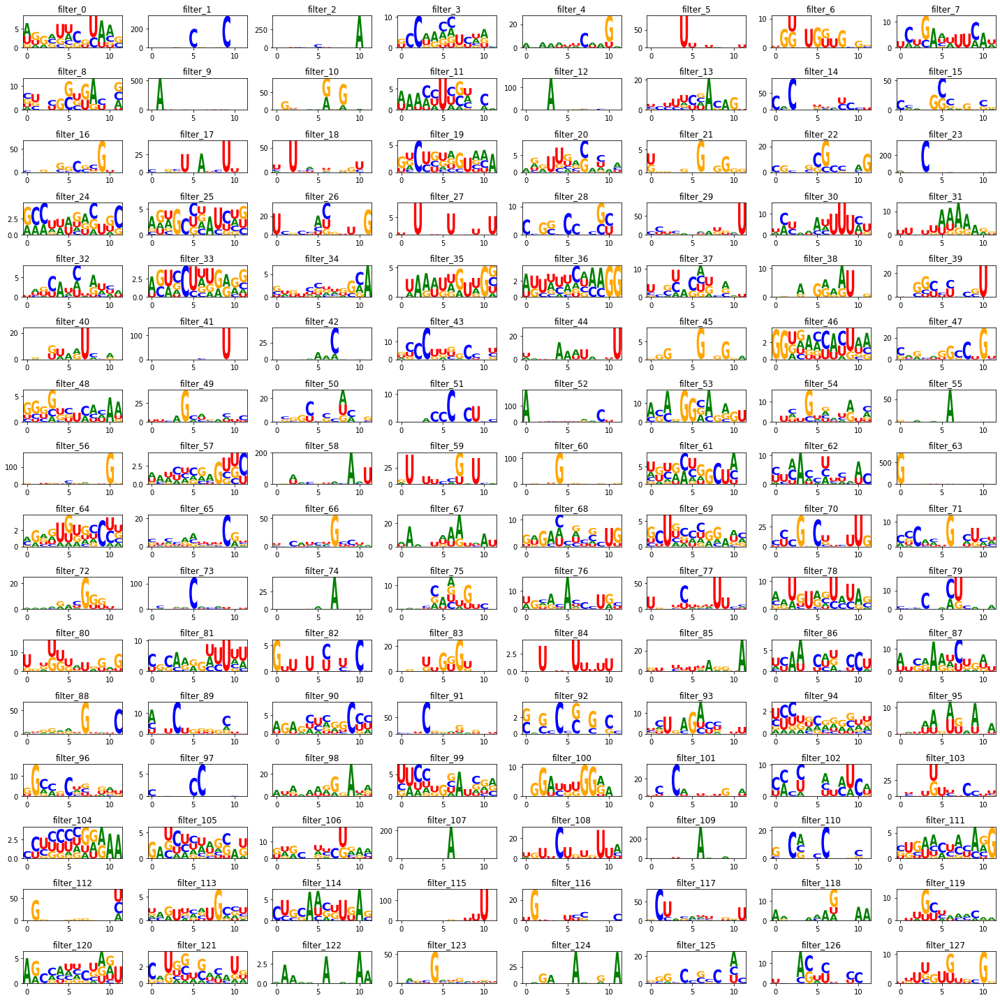

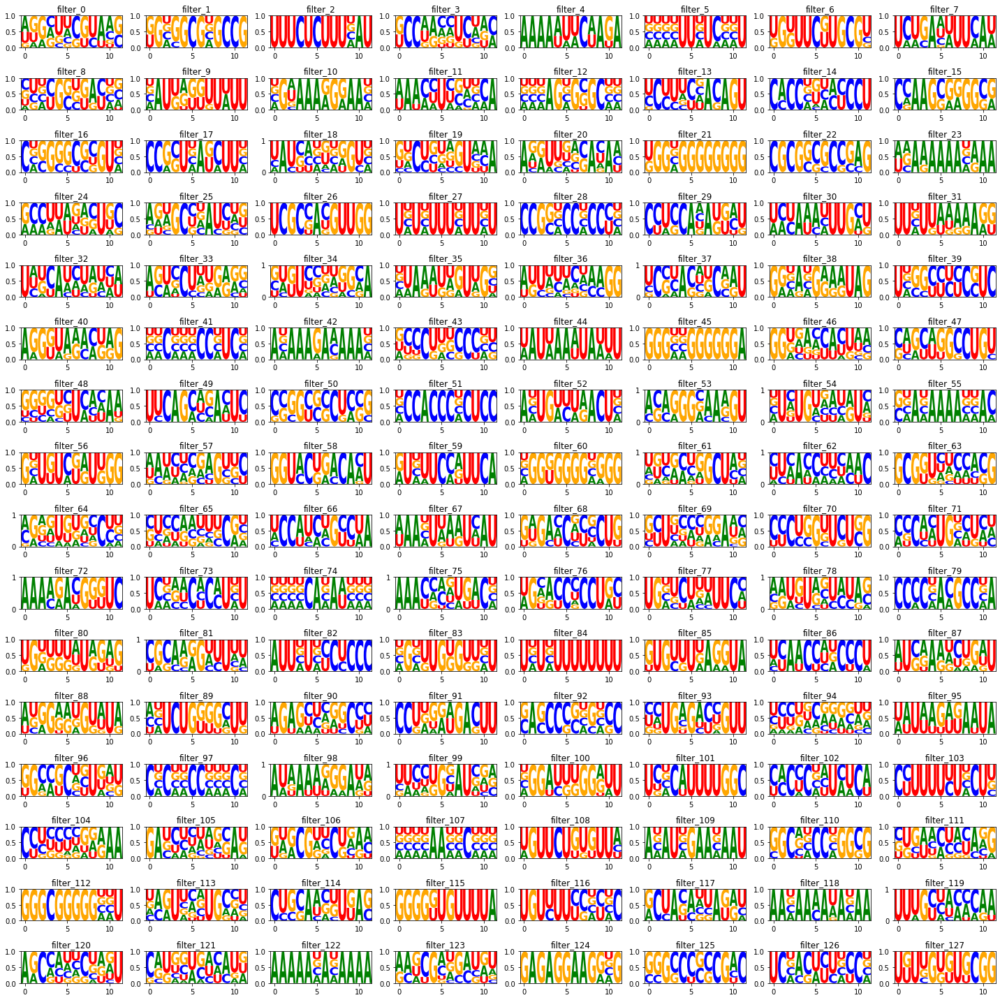

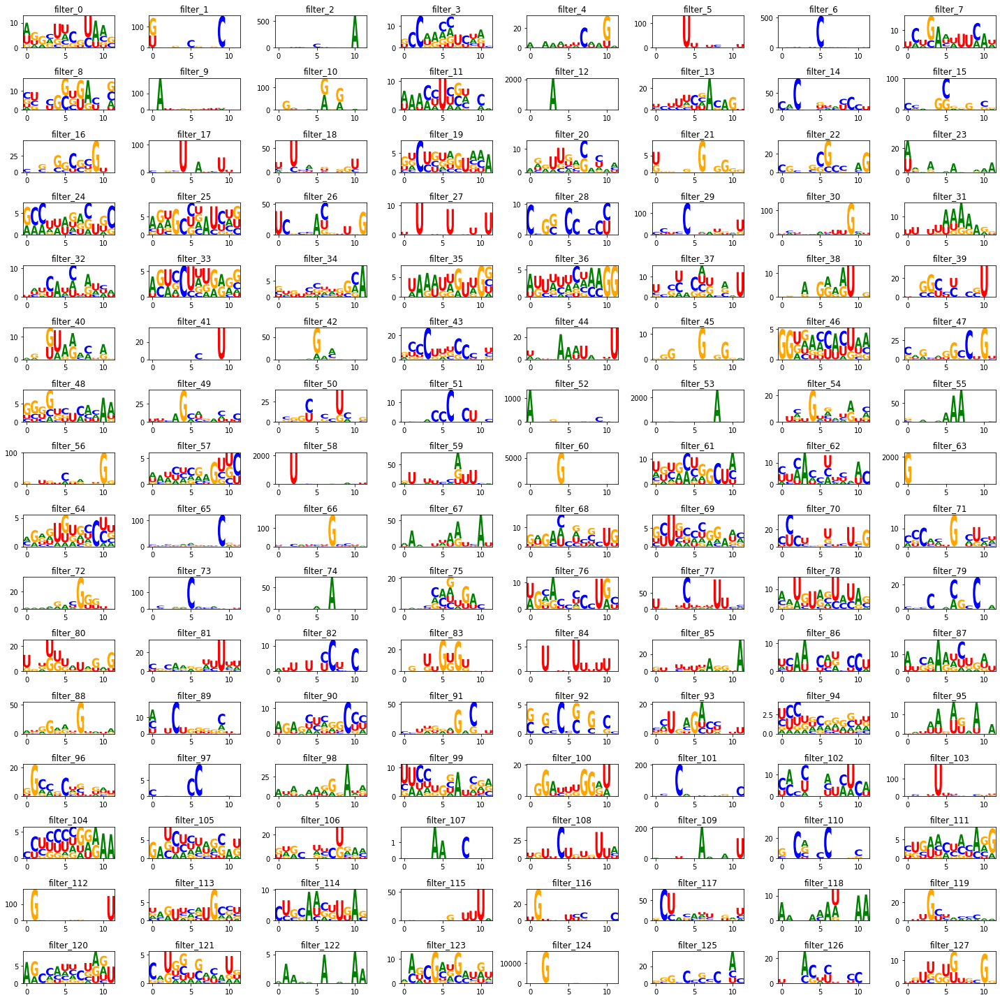

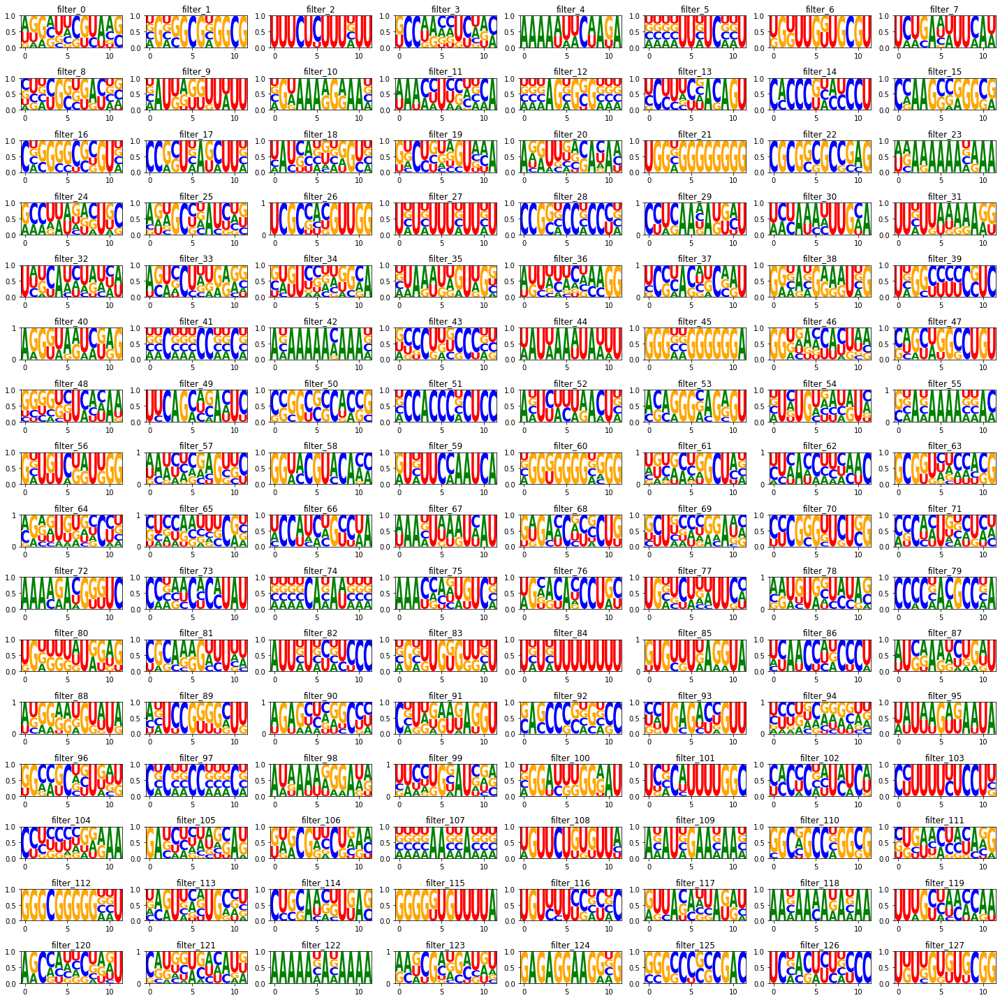

...

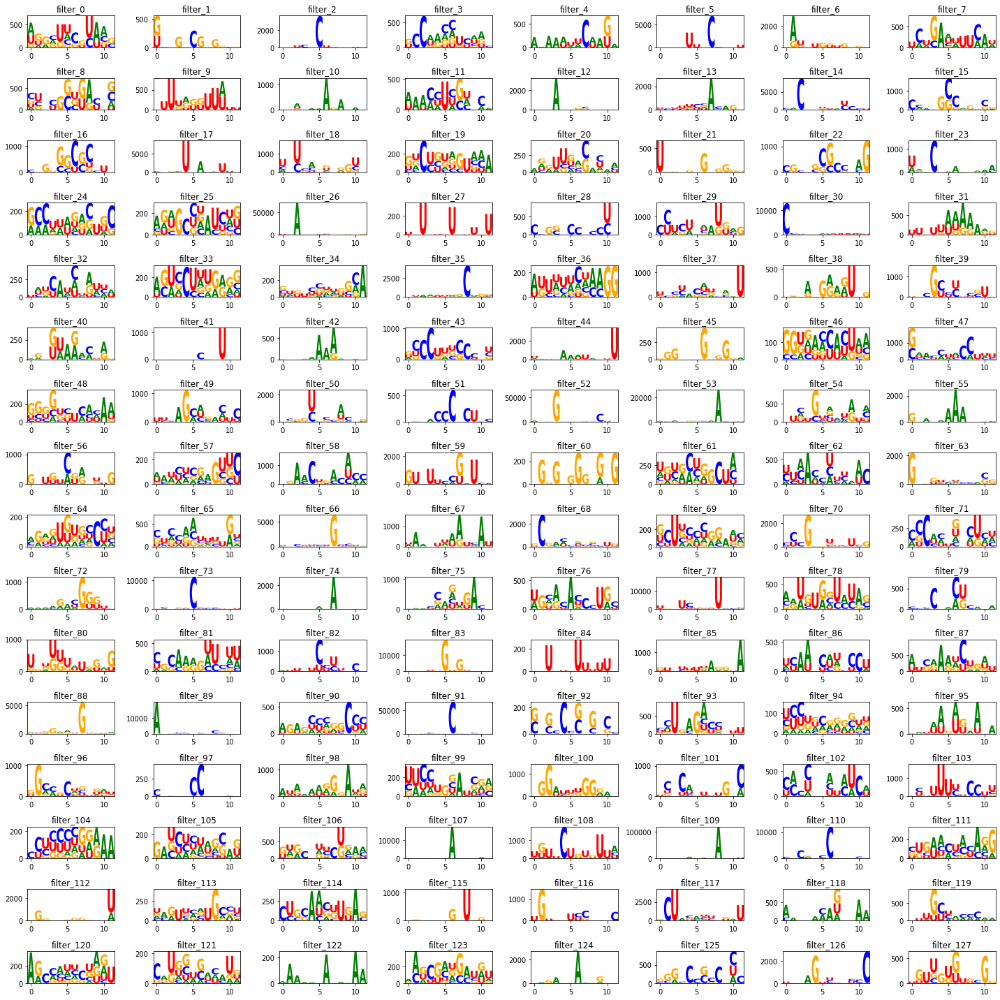

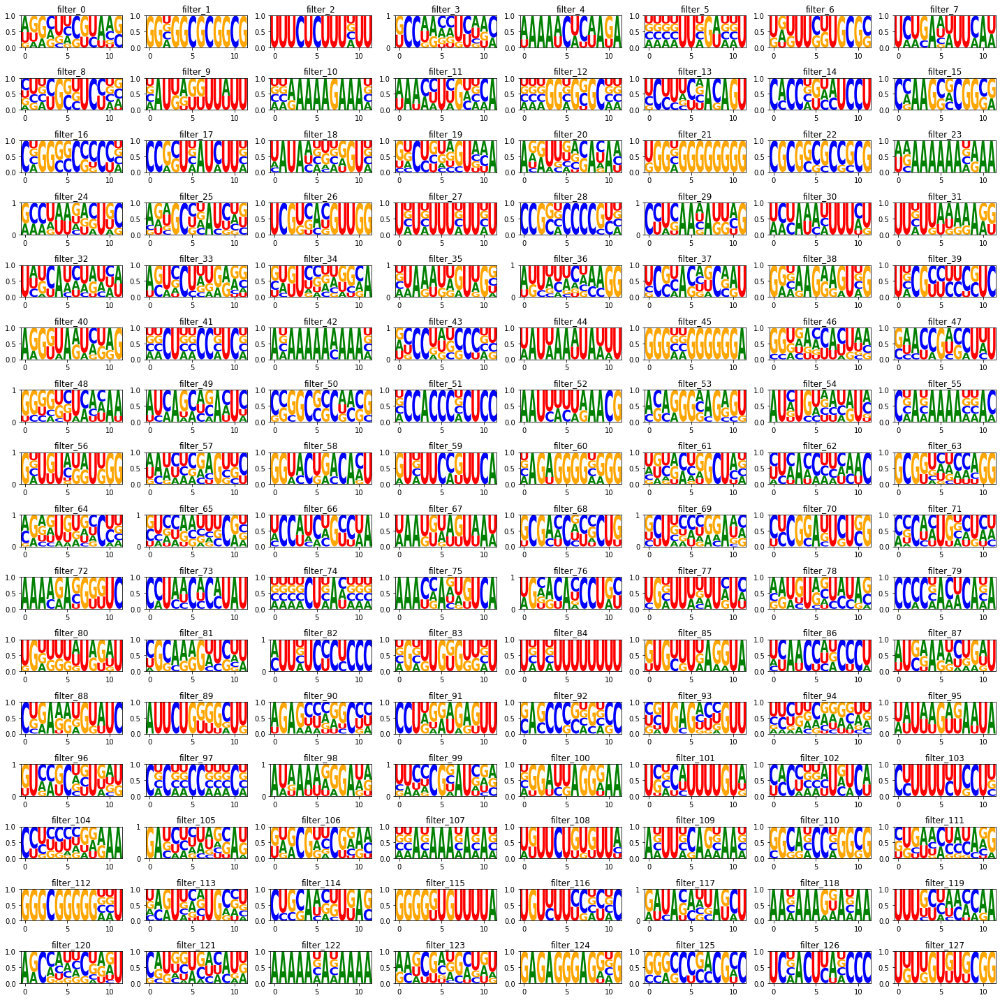

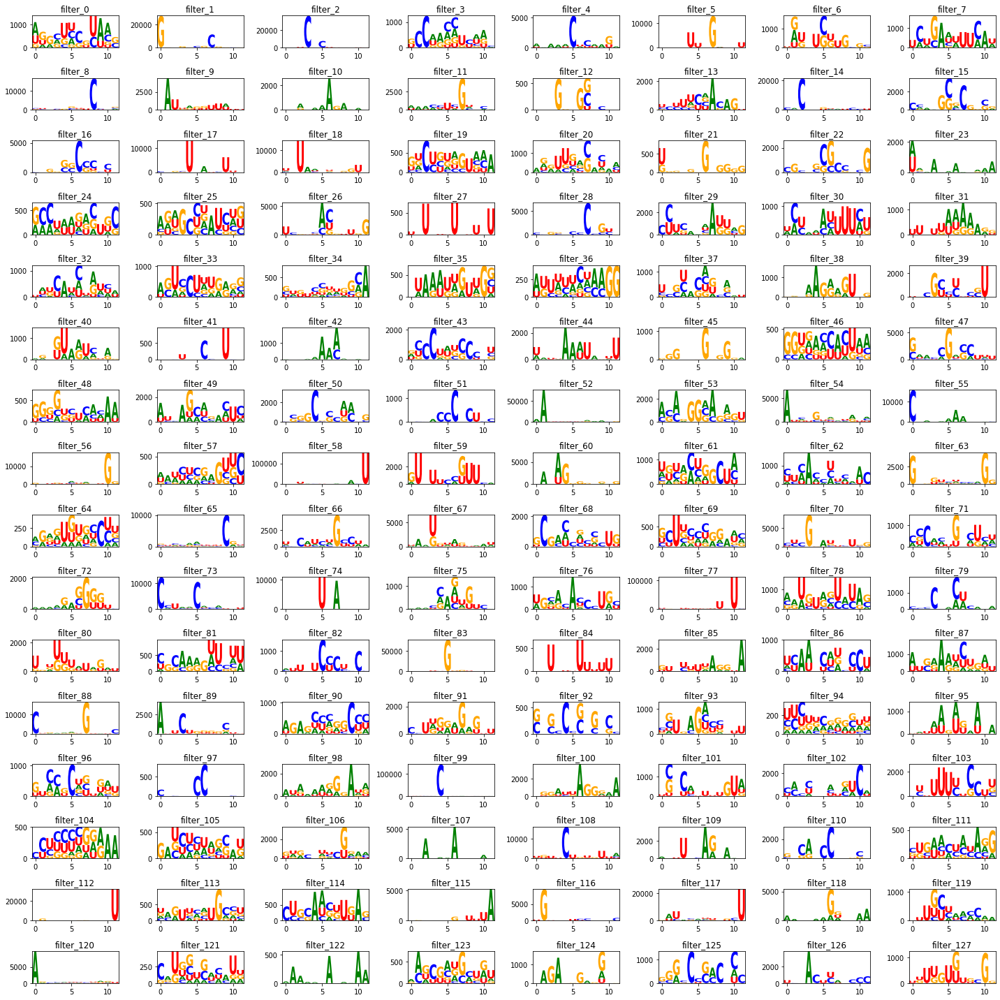

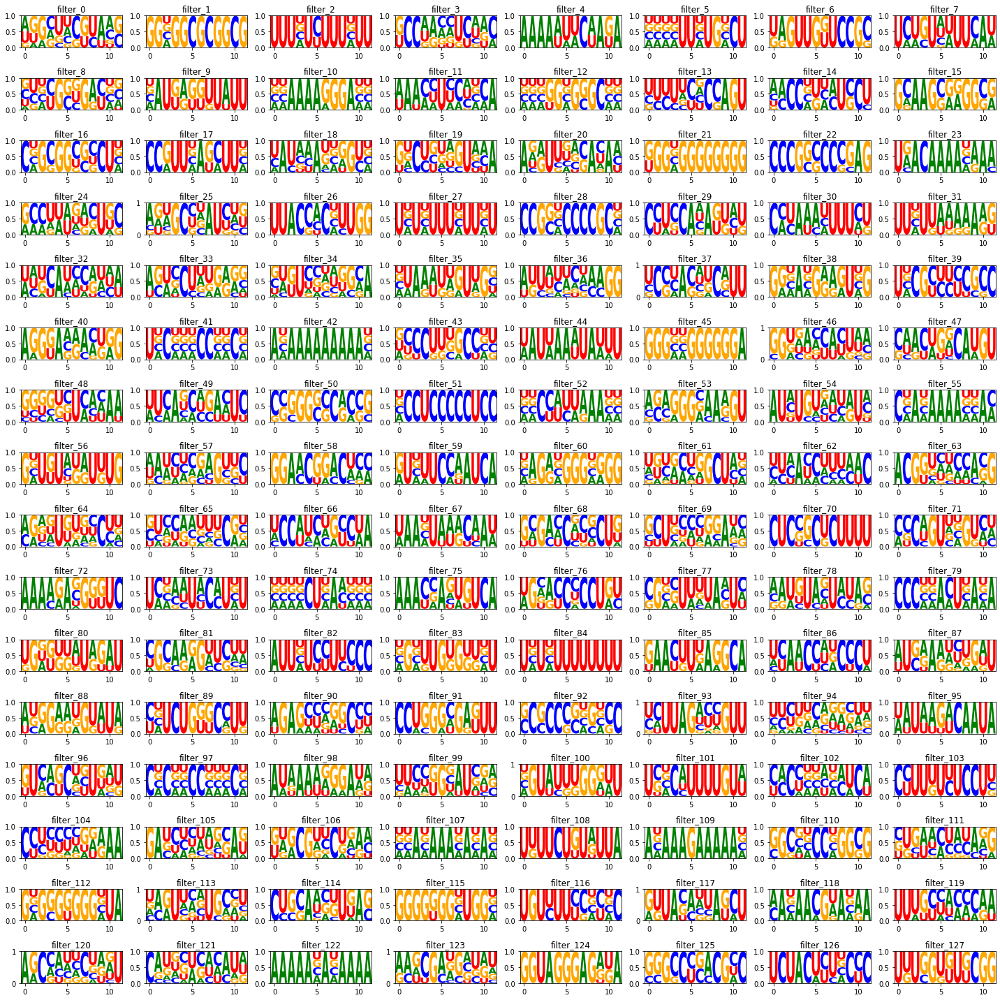

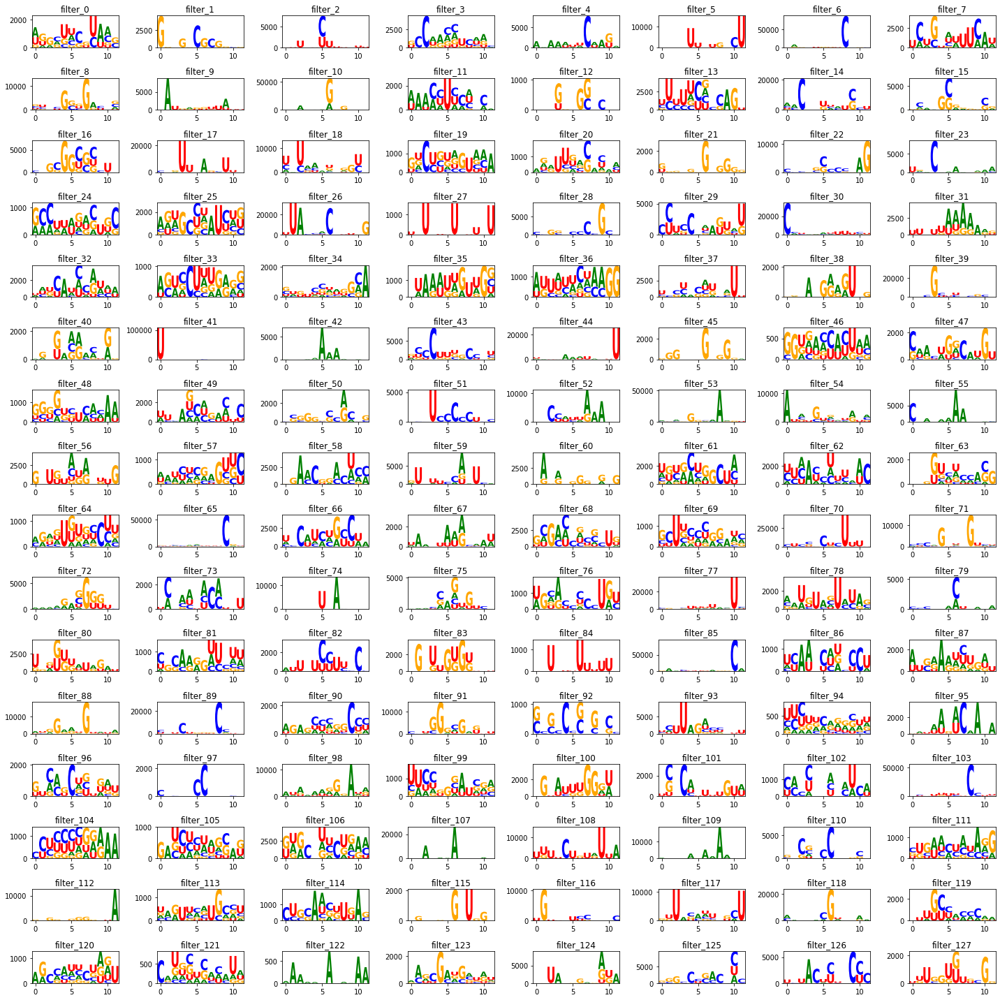

LogomakerError: some matrix elements are not finite. Set allow_nan=True to allow this.

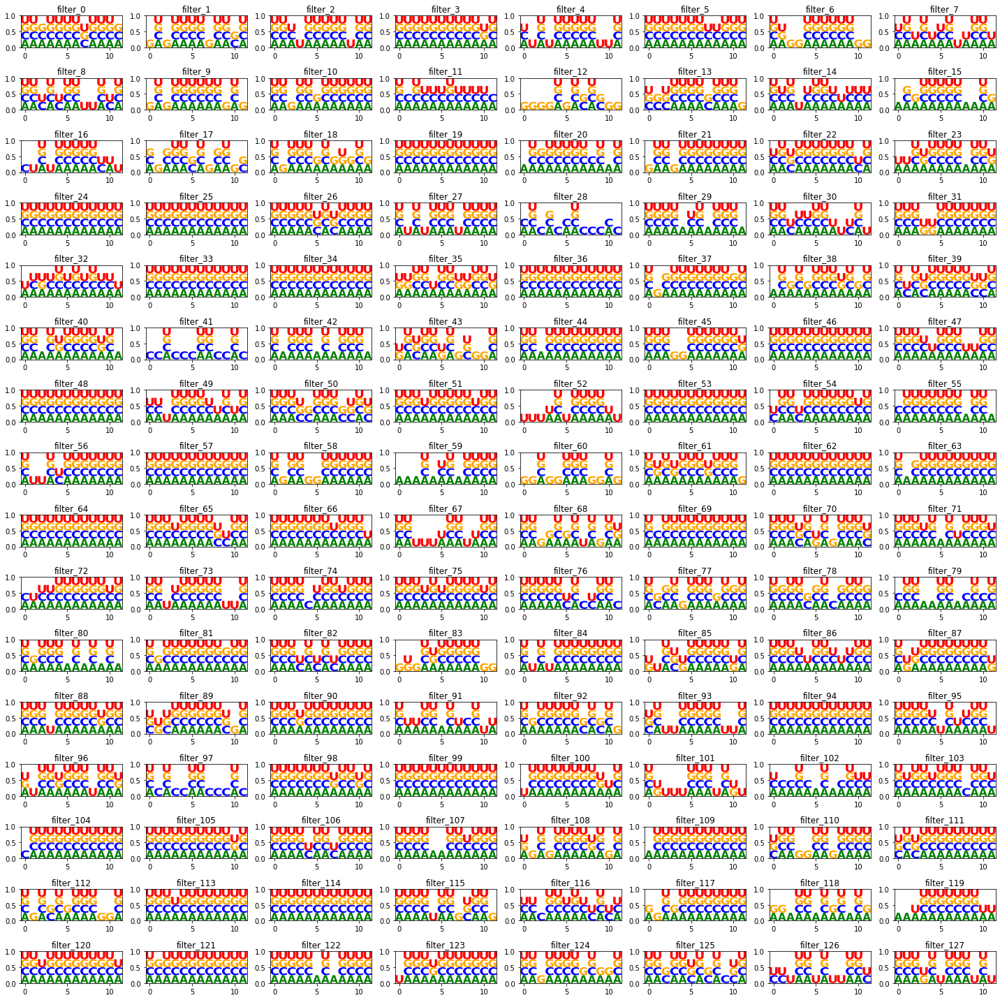

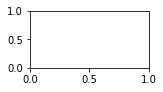

In [15]:
for ct in ct_filter_pwms.keys():
    plot_filter_processed_pwms(ct_filter_pwms[ct], ct)
    plot_filter_raw_pwms(ct_filter_pwms[ct], ct)
    make_meme_file(ct_filter_pwms[ct], f'sALS_{ct}')

In [16]:
for ct in ct_filter_pwms.keys():
    # plot_filter_processed_pwms(ct_filter_pwms[ct], ct)
    # plot_filter_raw_pwms(ct_filter_pwms[ct], ct)
    make_meme_file(ct_filter_pwms[ct], f'sALS_{ct}')

In [17]:
# save the filter_pwms dictionary into a pickle file
with open('data/sALS_CT_filter_pwms_CNN_Matt_V2_4_L2_resNet.pkl', 'wb') as handle:
    pickle.dump(ct_filter_pwms, handle, protocol=pickle.HIGHEST_PROTOCOL)